# Segmenting and Clustering Neighborhoods in Houston, Texas

### IBM Applied Data Science Capstone

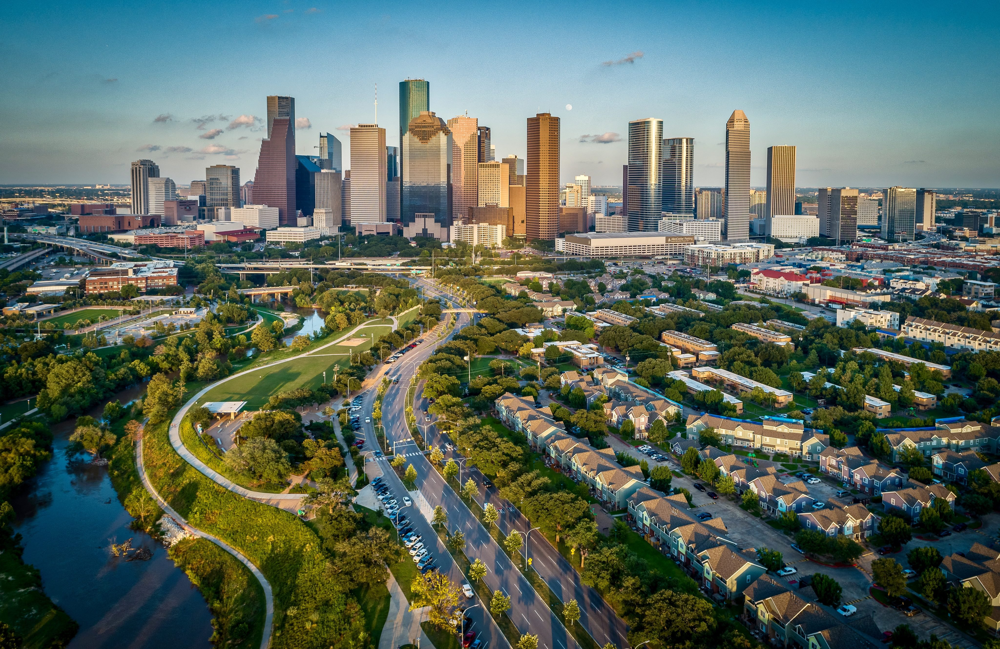

In [1]:
import requests # library to handle requests

# !pip install pillow
from PIL import Image

url = 'https://flyinglocksmiths.com/app/uploads/houston-4096x2659.jpeg'
im = Image.open(requests.get(url, stream=True).raw)
im

## Introduction

### Background

Houston is the most populous city in the U.S. state of Texas, fourth-most populous city in the United States, and sixth-most populous city in North America. With a high rate of growth, a lot of workers are moving to Houston to take advantage of employment opportunities there. As a cosmopolian destination, Houston is also filled with world-class dinning, arts, hotels, shopping and nightlife. To encourage business investments, attract talents and benefit citizens, open datasets provided by the city of Houston are available online for everyone to examine and develop. Thus, I conducted this location analysis to explore, analyze and cluster neighborhoods in the city of Houston to provide some ideas for new residents and new businesses.

### Data Source

All the data that will be used in my analysis are shown below. The first dataset on Wikipedia includes neighborhoods and location information for the city of Houston. The second dataset on Kaggle lists latitude and longitude information for the Houston neighborhoods. Last, I will use the Foursquare API to explore venues and cluster neighborhoods of Houston. See more information on my Github: https://github.com/AbigailYuHaixin.

1. List of Houston Neighborhoods: https://en.wikipedia.org/wiki/List_of_Houston_neighborhoods
2. Latitude and Longitude of Houston Neighborhoods: https://www.kaggle.com/mrchristolpher/houston-texas-neighborhoods-lat-long-list
3. Foursquare Developers Access to Location Data: https://developer.foursquare.com/developer/

## Analysis and Results

### Import Libraries and Datasets

In [2]:
import numpy as np # library for vectorized computation

import pandas as pd # library to process data as dataframes
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

from bs4 import BeautifulSoup

# !conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

# !conda install -c conda-forge folium=0.5.0 --yes
import folium # map rendering library

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

print('Libraries imported.')

Libraries imported.


In [3]:
url1 = 'https://en.wikipedia.org/wiki/List_of_Houston_neighborhoods'
extract_data = requests.get(url1).text
wiki = BeautifulSoup(extract_data, 'lxml')
print('Dataset `wiki` from Wikipedia imported.')

Dataset `wiki` from Wikipedia imported.


In [4]:
url2 = 'https://github.com/AbigailYuHaixin/Applied_Data_Science_Capstone_by_IBM_on_Coursera/blob/main/Houston_Texas_Neighborhoods_Lat_Long_List%20-%20Sheet1.csv?raw=true'
kaggle = pd.read_csv(url2)
print('Dataset `kaggle` from Kaggle imported.')

Dataset `kaggle` from Kaggle imported.


### Data Preprocessing

All analyses were conducted using Python version 3.8.5. A total of 88 neighborhoods in Houston were included. The original dataset from Wikipedia has 3 variables. The original dataset from Kaggle has 6 variables. I merged the two datasets on `Neighborhood`, then dropped `Boundaries` and `Full Address`. Thus, there are 88 observations of 6 variables in our dataset. The six variables are: `Neighborhood`, `Location`, `City`, `State`, `Latitude`, `Longitude`. The eighty-eight neighborhoods are shown in the map below.

#### 1. Convert HTML Table `wiki` to Pandas Dataframe

In [5]:
table = wiki.find('table')
content = table.find_all('td')

name = []
location = []
boundary = []

for i in range(0, len(content), 4):
    name.append(content[i+1].text.strip())
    location.append(content[i+2].text.strip())
    boundary.append(content[i+3].text.strip())
    
wiki = pd.DataFrame(data=[name, location, boundary]).transpose()
wiki.columns = ['Neighborhood','Location','Boundaries']
wiki.head()

,Neighborhood,Location,Boundaries
0,Willowbrook,Northwest,Along Texas State Highway 249 northwest of Bel...
1,Greater Greenspoint,North,Around the junction of Beltway 8 and Interstat...
2,Carverdale,Northwest,South of the junction of Beltway 8 and U.S. Ro...
3,Fairbanks / Northwest Crossing,Northwest,Along U.S. Route 290 between Interstate 610 an...
4,Greater Inwood,Northwest,North of Fairbanks / Northwest Crossing and ea...


In [6]:
print('The dataframe `wiki` has {} neighborhoods and {} locations relative to Downtown Houston.'.format(wiki.shape[0], len(wiki['Location'].unique())))

The dataframe `wiki` has 88 neighborhoods and 9 locations relative to Downtown Houston.


#### 2. Merge Dataframe `kaggle` to Dataframe `wiki` on `'Neighborhood'`

In [7]:
kaggle.head()

,Neighborhood,City,State,Latitude,Longitude,Full Address
0,Acres Home,Houston,Texas,29.870719,-95.436543,"Acres Home, Houston, Texas"
1,Addicks,Houston,Texas,29.813269,-95.645476,"Addicks, Houston, Texas"
2,Afton Oaks,Houston,Texas,29.736854,-95.453248,"Afton Oaks, Houston, Texas"
3,Alief,Houston,Texas,29.682720,-95.593239,"Alief, Houston, Texas"
4,Astrodome Area,Houston,Texas,29.685208,-95.403226,"Astrodome Area, Houston, Texas"


In [8]:
print('The dataframe `kaggle` has {} neighborhoods.'.format(kaggle.shape[0]))

The dataframe `kaggle` has 88 neighborhoods.


In [9]:
raw_part1 = pd.merge(wiki, kaggle, how='inner', on='Neighborhood')
print('The first part of the complete dataframe contains {} matched neighborhoods by INNER JOIN.'.format(raw_part1.shape[0]))

raw_part1 = raw_part1.drop(['Boundaries', 'Full Address'], axis=1)
raw_part1.head(3)

The first part of the complete dataframe contains 60 matched neighborhoods by INNER JOIN.


,Neighborhood,Location,City,State,Latitude,Longitude
0,Willowbrook,Northwest,Houston,Texas,29.955860,-95.545979
1,Greater Greenspoint,North,Houston,Texas,29.940679,-95.413906
2,Carverdale,Northwest,Houston,Texas,29.858708,-95.545162


In [10]:
wiki_key = wiki['Neighborhood'].isin(raw_part1['Neighborhood'])
kaggle_key =kaggle['Neighborhood'].isin(raw_part1['Neighborhood'])

wiki_remain = wiki[~wiki_key]
print('After excluding the matched neighborhood names, the rest of the `wiki` dataframe includes {} neighborhoods.'.format(wiki_remain.shape[0]))
kaggle_remain = kaggle[~kaggle_key]
print('After excluding the matched neighborhood names, the rest of the `kaggle` dataframe includes {} neighborhoods.'.format(kaggle_remain.shape[0]))

After excluding the matched neighborhood names, the rest of the `wiki` dataframe includes 28 neighborhoods.
After excluding the matched neighborhood names, the rest of the `kaggle` dataframe includes 28 neighborhoods.


In [11]:
raw_part2 = pd.merge(wiki_remain, kaggle_remain, how='inner', left_on=wiki_remain['Neighborhood'].str[:7], right_on=kaggle_remain['Neighborhood'].str[:7])
print('The second part of the complete dataframe contains the remaining {} neighborhoods.'.format(raw_part2.shape[0]))

raw_part2 = raw_part2.drop(['key_0', 'Neighborhood_y', 'Boundaries', 'Full Address'], axis=1).rename(columns={'Neighborhood_x': 'Neighborhood'})
raw_part2.head(3)

The second part of the complete dataframe contains the remaining 28 neighborhoods.


,Neighborhood,Location,City,State,Latitude,Longitude
0,Fairbanks / Northwest Crossing,Northwest,Houston,Texas,29.852726,-95.524386
1,Addicks / Park Ten,West,Houston,Texas,29.813269,-95.645476
2,Central Northwest (formerly Near Northwest),Northwest,Houston,Texas,29.832750,-95.444803


In [12]:
houston = pd.concat([raw_part1, raw_part2])
print('Thus, the complete dataset `houston` has {} observations and {} variables.'.format(houston.shape[0], houston.shape[1]))
houston.head()

Thus, the complete dataset `houston` has 88 observations and 6 variables.


,Neighborhood,Location,City,State,Latitude,Longitude
0,Willowbrook,Northwest,Houston,Texas,29.955860,-95.545979
1,Greater Greenspoint,North,Houston,Texas,29.940679,-95.413906
2,Carverdale,Northwest,Houston,Texas,29.858708,-95.545162
3,Greater Inwood,Northwest,Houston,Texas,29.865739,-95.480434
4,Acres Home,Northwest,Houston,Texas,29.870719,-95.436543


#### 3. Create a Map of Houston with Neighborhoods Superimposed on Top

In [13]:
address = 'Houston, TX'

geolocator = Nominatim(user_agent="hou_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Houston are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Houston are 29.7589382, -95.3676974.


In [14]:
# create map of Houston using latitude and longitude values
map_houston = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, location, neighborhood in zip(houston['Latitude'], houston['Longitude'], houston['Location'], houston['Neighborhood']):
    label = '{}, {}'.format(neighborhood, location)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker([lat, lng],
                        radius=5,
                        popup=label,
                        color='blue',
                        fill=True,
                        fill_color='#3186cc',
                        fill_opacity=0.7,
                        parse_html=False).add_to(map_houston)
    
map_houston

### Explore and Segment Neighborhoods Using Foursquare API

Based on the location information provided in our dataset, I used the Foursquare API to explore and segment the neighborhoods in Houston. My explorations showed that the number of venue category in each neighborhood within a radius of 1500 meters (less than 1 mile) varied from 2 to 100 . Minnetex has the fewest variety of venues: Discount Store and IT Services. There are 15 neighborhoods have the largest number of venue categories: Afton Oaks/River Oaks, Downtown, Fourth Ward, Greater Heights, Greater Uptown, Greenway/Upper Kirby, Medical Center, Mid-West, Midtown, Museum Park, Neartown/Montrose, Spring Branch East, Spring Branch West, University Place, and Willowbrook. Of all the returned venues, there is a total of 325 unique categories. To know each neighborhood more deeply, I checked the frequency of occurance for each category by neighborhood. I also put the top 10 venues for each neighborhood into a new dataframe. For instance, the top 10 venues for the neighborhood Acres Home are Construction & Landscaping, Food, Chinese Restaurant, Discount Store, Locksmith, Bus Station, Dumpling Restaurant, Eastern European Restaurant, Electronics Store, and Empanada Restaurant.

K-means clustering was used to segment the neighborhoods into 5 clusters. By visualizing the resulting clusters in the map below, we can conclude that Houston is a well balanced city. Most of the neighborhoods are in the same cluster. The first cluster has 8 neighborhoods: Acres Home, Clinton Park/Tri-Community, East Houston, East Little York/Homestead, EL Dorado/Oates Prairie, Minnetex, Settegast, and South Park. All the eight neighborhoods have dry cleaners. Six of them have donut shops, construction & lanscaping, and discount stores. Four have duty-free shops and dog run. And three have gas stations and doctor's offices. It all sounds like a great place to live. But they are relatively far from downtown Houston and scattered along the northeastern and southern edges of the city. The second cluster includes 90% of the neighborhoods in Houston. Of these 77 neighborhoods, more than half have Mexican Restaurants and fast food restaurants. Other common venues are sandwich place, pizza place, fired chicken joint, and coffee shops. This indicates that Houston is a fast-paced but very convenient city. And because Texas is very close to Mexico, there are a lot of Mexican restaurants in Houston. The third cluster, fourth cluster, and fifth cluster all have one neighborhood. They are Hunterwood, Harrisburg/Manchester and Lake Houston. Hunterwood has auto shop, business service, and home service. It is like a traditional business area. Harrisburg/Manchester has shops, restaurants, zoo exhibit, and marine terminal. Obviously, it is near the sea and must be a fun place to go. Lake Houston also has shops, restaurants, and zoo exhibit. And it has a flea market.

#### 1. Define Foursquare Credentials and Version

In [15]:
CLIENT_ID = 'NWD5OI355TFOXZ3CSBHRO4PGITCS30GYO0CRDQGPEIUZJLJJ' # your Foursquare ID
CLIENT_SECRET = 'WD4TUM4MP44EXFJVIGVVGWCTDHWNXQTWKIKFUGYEBZSYRAYQ' # your Foursquare Secret
VERSION = '20210121' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: NWD5OI355TFOXZ3CSBHRO4PGITCS30GYO0CRDQGPEIUZJLJJ
CLIENT_SECRET:WD4TUM4MP44EXFJVIGVVGWCTDHWNXQTWKIKFUGYEBZSYRAYQ


#### 2. Explore Neighborhoods in Houston

Let's create a function to repeat the exploring process for all neighborhoods in Houston.

In [16]:
houston.sort_values(['Neighborhood'], ignore_index=True, inplace=True) # sort neighborhoods alphabetically

In [17]:
def getNearbyVenues(names, latitudes, longitudes, radius=1500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood',
                             'Neighborhood Latitude',
                             'Neighborhood Longitude',
                             'Venue',
                             'Venue Latitude',
                             'Venue Longitude',
                             'Venue Category']
    
    return(nearby_venues)

Run the above function on each neighborhood and create a dataframe called houston_venues.

In [18]:
houston_venues = getNearbyVenues(names=houston['Neighborhood'], latitudes=houston['Latitude'], longitudes=houston['Longitude'])

Acres Home
Addicks / Park Ten
Afton Oaks / River Oaks
Alief
Astrodome Area
Braeburn
Braeswood
Brays Oaks (formerly Greater Fondren S.W.)
Briar Forest
Carverdale
Central Northwest (formerly Near Northwest)
Central Southwest
Clear Lake
Clinton Park / Tri-Community
Denver Harbor / Port Houston
Downtown
East Houston
East Little York / Homestead
Edgebrook
El Dorado / Oates Prairie
Eldridge / West Oaks
Fairbanks / Northwest Crossing
Fondren Gardens
Fort Bend / Houston
Fourth Ward
Golfcrest / Bellfort / Reveille
Greater Eastwood
Greater Fifth Ward
Greater Greenspoint
Greater Heights
Greater Hobby Area
Greater Inwood
Greater OST / South Union
Greater Third Ward
Greater Uptown
Greenway / Upper Kirby
Gulfgate Riverview / Pine Valley
Gulfton
Harrisburg / Manchester
Hidden Valley
Hunterwood
IAH Airport
Independence Heights
Jensen
Kashmere Gardens
Kingwood
Lake Houston
Langwood
Lawndale / Wayside
Lazybrook / Timbergrove
MacGregor
Magnolia Park
Meadowbrook / Allendale
Medical Center
Memorial
Meyerla

Let's check the size of the resulting dataframe.

In [19]:
print(houston_venues.shape)
houston_venues.head()

(4030, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Acres Home,29.870719,-95.436543,Family Dollar,29.872253,-95.437729,Discount Store
1,Acres Home,29.870719,-95.436543,METRO Acres Homes Transit Center,29.864708,-95.430969,Bus Station
2,Acres Home,29.870719,-95.436543,Chick Chung,29.863635,-95.428402,Chinese Restaurant
3,Acres Home,29.870719,-95.436543,Vera Steel,29.861840,-95.442030,Construction & Landscaping
4,Acres Home,29.870719,-95.436543,Cozy Corner,29.870251,-95.423470,Food


Let's check how many venues were returned for each neighborhood.

In [20]:
houston_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Acres Home,5,5,5,5,5,5
Addicks / Park Ten,5,5,5,5,5,5
Afton Oaks / River Oaks,100,100,100,100,100,100
Alief,30,30,30,30,30,30
Astrodome Area,76,76,76,76,76,76
Braeburn,58,58,58,58,58,58
Braeswood,27,27,27,27,27,27
Brays Oaks (formerly Greater Fondren S.W.),26,26,26,26,26,26
Briar Forest,74,74,74,74,74,74


Let's see how many unique categories can be curated from all the returned venues.

In [21]:
print('There are {} uniques categories.'.format(len(houston_venues['Venue Category'].unique())))

There are 323 uniques categories.


#### 3. Analyze Each Neighborhood

In [22]:
# one hot encoding
houston_onehot = pd.get_dummies(houston_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
houston_onehot['Neighborhood'] = houston_venues['Neighborhood']

# move neighborhood column to the first column
houston_onehot = houston_onehot[['Neighborhood'] + [col for col in houston_onehot.columns if col != 'Neighborhood']]

print('The size of the new dataframe is {}.'.format(houston_onehot.shape))
houston_onehot.head()

The size of the new dataframe is (4030, 323).


,Neighborhood,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Antique Shop,Aquarium,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Assisted Living,Astrologer,Athletics & Sports,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bay,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Shop,Bike Trail,Bistro,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Caribbean Restaurant,Casino,Check Cashing Service,Chinese Restaurant,Chocolate Shop,Churrascaria,Clothing Store,Cocktail Bar,Coffee Shop,College Baseball Diamond,College Football Field,College Gym,College Rec Center,College Residence Hall,College Theater,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Creperie,Cuban Restaurant,Cupcake Shop,Currency Exchange,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Disc Golf,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Escape Room,Event Service,Exhibit,Eye Doctor,Fabric Shop,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,General Travel,German Restaurant,Gift Shop,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Insurance Office,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Lawyer,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Mac & Cheese Joint,Marine Terminal,Market,Martial Arts School,Massage Studio,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Nightclub,Noodle House,Opera House,Optical Shop,Other Repair Shop,Outdoor Sculpture,Outdoor Supply Store,Outdoors & Recreation,Paintball Field,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pawn Shop,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Piano Bar,Picnic Area,Pie Shop,Pizza Place,Playground,Plaza,Poke Place,Pool,Portuguese Restaurant,Print Shop,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Science Museum,Sculpture Garden,Seafood Restaurant,Shabu-Shabu Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Smoke Shop,Smoothie Shop,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Southern / Soul Food Restaurant,Sp

Let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category.

In [23]:
houston_grouped = houston_onehot.groupby('Neighborhood').mean().reset_index()
print('The size of this dataframe is {}.'.format(houston_grouped.shape))
houston_grouped.head()

The size of this dataframe is (88, 323).


,Neighborhood,ATM,Accessories Store,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Antique Shop,Aquarium,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Assisted Living,Astrologer,Athletics & Sports,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bay,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Shop,Bike Trail,Bistro,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Camera Store,Caribbean Restaurant,Casino,Check Cashing Service,Chinese Restaurant,Chocolate Shop,Churrascaria,Clothing Store,Cocktail Bar,Coffee Shop,College Baseball Diamond,College Football Field,College Gym,College Rec Center,College Residence Hall,College Theater,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Creperie,Cuban Restaurant,Cupcake Shop,Currency Exchange,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Disc Golf,Discount Store,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store,Empanada Restaurant,Escape Room,Event Service,Exhibit,Eye Doctor,Fabric Shop,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,General Travel,German Restaurant,Gift Shop,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gymnastics Gym,Halal Restaurant,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Insurance Office,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Lawyer,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Mac & Cheese Joint,Marine Terminal,Market,Martial Arts School,Massage Studio,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Mongolian Restaurant,Motel,Motorcycle Shop,Movie Theater,Moving Target,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Nightclub,Noodle House,Opera House,Optical Shop,Other Repair Shop,Outdoor Sculpture,Outdoor Supply Store,Outdoors & Recreation,Paintball Field,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pawn Shop,Performing Arts Venue,Persian Restaurant,Peruvian Restaurant,Pet Service,Pet Store,Pharmacy,Piano Bar,Picnic Area,Pie Shop,Pizza Place,Playground,Plaza,Poke Place,Pool,Portuguese Restaurant,Print Shop,Pub,Public Art,Ramen Restaurant,Record Shop,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Science Museum,Sculpture Garden,Seafood Restaurant,Shabu-Shabu Restaurant,Shipping Store,Shoe Store,Shopping Mall,Skate Park,Smoke Shop,Smoothie Shop,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Southern / Soul Food Restaurant,Sp

Let's print each neighborhood along with the top 5 most common venues.

In [24]:
num_top_venues = 5

for hood in houston_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = houston_grouped[houston_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Acres Home----
                        venue  freq
0                        Food   0.2
1  Construction & Landscaping   0.2
2              Discount Store   0.2
3          Chinese Restaurant   0.2
4                 Bus Station   0.2


----Addicks / Park Ten----
                   venue  freq
0                  Trail   0.2
1                Dog Run   0.2
2  Outdoors & Recreation   0.2
3    Government Building   0.2
4                    Bar   0.2


----Afton Oaks / River Oaks----
                    venue  freq
0          Clothing Store  0.06
1        Department Store  0.05
2                   Hotel  0.04
3     American Restaurant  0.04
4  Furniture / Home Store  0.04


----Alief----
                  venue  freq
0           Pizza Place  0.10
1  Fast Food Restaurant  0.10
2         Grocery Store  0.07
3           Video Store  0.07
4        Discount Store  0.07


----Astrodome Area----
               venue  freq
0          BBQ Joint  0.04
1  Mobile Phone Shop  0.04
2      Grocery Store  

Let's put the above results into a new dataframe and display the top 10 venues for each neighborhood.

In [25]:
# function to sort the venues in descending order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [26]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = houston_grouped['Neighborhood']

for ind in np.arange(houston_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(houston_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Acres Home,Construction & Landscaping,Food,Discount Store,Bus Station,Chinese Restaurant,Zoo Exhibit,Empanada Restaurant,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
1,Addicks / Park Ten,Bar,Trail,Dog Run,Outdoors & Recreation,Government Building,Dive Bar,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
2,Afton Oaks / River Oaks,Clothing Store,Department Store,American Restaurant,Furniture / Home Store,Hotel,Steakhouse,Shopping Mall,French Restaurant,Women's Store,Coffee Shop
3,Alief,Pizza Place,Fast Food Restaurant,Video Store,Discount Store,Grocery Store,Gas Station,Fried Chicken Joint,Taco Place,Supplement Shop,Pet Store
4,Astrodome Area,Mobile Phone Shop,BBQ Joint,Grocery Store,Sandwich Place,Food Truck,Hotel,Chinese Restaurant,Mexican Restaurant,Fast Food Restaurant,Filipino Restaurant


#### 4. Cluster Neighborhoods in Houston

Run k-means to cluster the neighborhoods into 5 clusters.

In [27]:
# set number of clusters
kclusters = 5

houston_grouped_clustering = houston_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(houston_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([0, 1, 1, 1, 1, 1, 1, 1, 1, 1])

Let's create a new dataframe that includes the clusters as well as the top 10 venues for each neighborhood.

In [28]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

houston_merged = houston

# merge neighborhoods_venues_sorted with houston to add latitude/longitude for each neighborhood
houston_merged = houston_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')
houston_merged.head()

,Neighborhood,Location,City,State,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Acres Home,Northwest,Houston,Texas,29.870719,-95.436543,0,Construction & Landscaping,Food,Discount Store,Bus Station,Chinese Restaurant,Zoo Exhibit,Empanada Restaurant,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
1,Addicks / Park Ten,West,Houston,Texas,29.813269,-95.645476,1,Bar,Trail,Dog Run,Outdoors & Recreation,Government Building,Dive Bar,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
2,Afton Oaks / River Oaks,West,Houston,Texas,29.736854,-95.453248,1,Clothing Store,Department Store,American Restaurant,Furniture / Home Store,Hotel,Steakhouse,Shopping Mall,French Restaurant,Women's Store,Coffee Shop
3,Alief,Southwest,Houston,Texas,29.682720,-95.593239,1,Pizza Place,Fast Food Restaurant,Video Store,Discount Store,Grocery Store,Gas Station,Fried Chicken Joint,Taco Place,Supplement Shop,Pet Store
4,Astrodome Area,South,Houston,Texas,29.685208,-95.403226,1,Mobile Phone Shop,BBQ Joint,Grocery Store,Sandwich Place,Food Truck,Hotel,Chinese Restaurant,Mexican Restaurant,Fast Food Restaurant,Filipino Restaurant


Let's check how many neighborhoods were included in each cluster.

In [29]:
houston_merged.groupby('Cluster Labels').count()

,Neighborhood,Location,City,State,Latitude,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Cluster Labels,,,,,,,,,,,,,,,,
0,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8
1,77,77,77,77,77,77,77,77,77,77,77,77,77,77,77,77
2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Finally, let's visualize the resulting clusters.

In [30]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(houston_merged['Latitude'], houston_merged['Longitude'], houston_merged['Neighborhood'], houston_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster + 1), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

#### 5. Examine Clusters

Let's examine each cluster and determine the discriminating venue categories that distinguish each cluster.

**Cluster 1**

In [31]:
cluster1 = houston_merged.loc[houston_merged['Cluster Labels'] == 0, houston_merged.columns[[0] + list(range(6, houston_merged.shape[1]))]]
cluster1.head()

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Acres Home,0,Construction & Landscaping,Food,Discount Store,Bus Station,Chinese Restaurant,Zoo Exhibit,Empanada Restaurant,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
13,Clinton Park / Tri-Community,0,Boat or Ferry,Gas Station,Harbor / Marina,Empanada Restaurant,Dog Run,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant
16,East Houston,0,Discount Store,Fried Chicken Joint,Home Service,Construction & Landscaping,Convenience Store,Seafood Restaurant,BBQ Joint,Museum,Donut Shop,Dry Cleaner
17,East Little York / Homestead,0,Discount Store,Grocery Store,Construction & Landscaping,Convenience Store,Gas Station,Brewery,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
19,El Dorado / Oates Prairie,0,Ice Cream Shop,Construction & Landscaping,Rental Car Location,Shipping Store,Eastern European Restaurant,Dive Bar,Doctor's Office,Dog Run,Donut Shop,Dry Cleaner


Let's take a look at the most common venues in cluster 1 as a whole.

In [32]:
cluster1_venues = cluster1.iloc[:, 2:12]
cluster1_venues_reshape = cluster1_venues.stack().reset_index()
cluster1_venues_count = cluster1_venues_reshape.groupby(0).count()

cluster1_common_venues = cluster1_venues_count.sort_values(['level_0'], ascending=False)
cluster1_common_venues.head(10)

,level_0,level_1
0,,
Dry Cleaner,8,8
Donut Shop,6,6
Construction & Landscaping,6,6
Discount Store,6,6
Dumpling Restaurant,5,5
Duty-free Shop,4,4
Dog Run,4,4
Gas Station,3,3
Doctor's Office,3,3


**Cluster 2**

In [33]:
cluster2 = houston_merged.loc[houston_merged['Cluster Labels'] == 1, houston_merged.columns[[0] + list(range(6, houston_merged.shape[1]))]]
cluster2.head()

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Addicks / Park Ten,1,Bar,Trail,Dog Run,Outdoors & Recreation,Government Building,Dive Bar,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop
2,Afton Oaks / River Oaks,1,Clothing Store,Department Store,American Restaurant,Furniture / Home Store,Hotel,Steakhouse,Shopping Mall,French Restaurant,Women's Store,Coffee Shop
3,Alief,1,Pizza Place,Fast Food Restaurant,Video Store,Discount Store,Grocery Store,Gas Station,Fried Chicken Joint,Taco Place,Supplement Shop,Pet Store
4,Astrodome Area,1,Mobile Phone Shop,BBQ Joint,Grocery Store,Sandwich Place,Food Truck,Hotel,Chinese Restaurant,Mexican Restaurant,Fast Food Restaurant,Filipino Restaurant
5,Braeburn,1,Pharmacy,Clothing Store,Cosmetics Shop,Liquor Store,Rental Car Location,Sandwich Place,Bar,Breakfast Spot,Discount Store,Chinese Restaurant


In [34]:
cluster2_venues = cluster2.iloc[:, 2:12]
cluster2_venues_reshape = cluster2_venues.stack().reset_index()
cluster2_venues_count = cluster2_venues_reshape.groupby(0).count()

cluster2_common_venues = cluster2_venues_count.sort_values(['level_0'], ascending=False)
cluster2_common_venues.head(10)

,level_0,level_1
0,,
Mexican Restaurant,43,43
Fast Food Restaurant,41,41
Sandwich Place,37,37
Pizza Place,33,33
Fried Chicken Joint,25,25
Discount Store,23,23
Coffee Shop,21,21
Gas Station,20,20
Burger Joint,20,20


**Cluster 3**

In [35]:
cluster3 = houston_merged.loc[houston_merged['Cluster Labels'] == 2, houston_merged.columns[[0] + list(range(6, houston_merged.shape[1]))]]
cluster3.head()

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
40,Hunterwood,2,Ice Cream Shop,Auto Workshop,Home Service,Business Service,Empanada Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant


In [36]:
cluster3_venues = cluster3.iloc[:, 2:12]
cluster3_venues_reshape = cluster3_venues.stack().reset_index()
cluster3_venues_count = cluster3_venues_reshape.groupby(0).count()

cluster3_common_venues = cluster3_venues_count.sort_values(['level_0'], ascending=False)
cluster3_common_venues.head()

,level_0,level_1
0,,
Auto Workshop,1,1
Business Service,1,1
Donut Shop,1,1
Dry Cleaner,1,1
Dumpling Restaurant,1,1


**Cluster 4**

In [37]:
cluster4 = houston_merged.loc[houston_merged['Cluster Labels'] == 3, houston_merged.columns[[0] + list(range(6, houston_merged.shape[1]))]]
cluster4.head()

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
38,Harrisburg / Manchester,3,Marine Terminal,Park,Zoo Exhibit,Empanada Restaurant,Dog Run,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant


In [38]:
cluster4_venues = cluster4.iloc[:, 2:12]
cluster4_venues_reshape = cluster4_venues.stack().reset_index()
cluster4_venues_count = cluster4_venues_reshape.groupby(0).count()

cluster4_common_venues = cluster4_venues_count.sort_values(['level_0'], ascending=False)
cluster4_common_venues.head()

,level_0,level_1
0,,
Dog Run,1,1
Donut Shop,1,1
Dry Cleaner,1,1
Dumpling Restaurant,1,1
Duty-free Shop,1,1


**Cluster 5**

In [39]:
cluster5 = houston_merged.loc[houston_merged['Cluster Labels'] == 4, houston_merged.columns[[0] + list(range(6, houston_merged.shape[1]))]]
cluster5.head()

,Neighborhood,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
46,Lake Houston,4,Business Service,Zoo Exhibit,Flea Market,Dog Run,Donut Shop,Dry Cleaner,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Electronics Store


In [40]:
cluster5_venues = cluster5.iloc[:, 2:12]
cluster5_venues_reshape = cluster5_venues.stack().reset_index()
cluster5_venues_count = cluster5_venues_reshape.groupby(0).count()

cluster5_common_venues = cluster5_venues_count.sort_values(['level_0'], ascending=False)
cluster5_common_venues.head()

,level_0,level_1
0,,
Business Service,1,1
Dog Run,1,1
Donut Shop,1,1
Dry Cleaner,1,1
Dumpling Restaurant,1,1


## Conclusion

I conducted this location analysis to explore, analyze and cluster neighborhoods in Houston to provide ideas for new residents and new businesses. Overall, Houston is a well developed city. Most of the neighborhoods are in the same cluster. If you are a young resident, cluster 2 probably has everthing you want. If you are a middle-aged resident with child or an elderly person, then cluster 1 may be a good choice. You can have a relatively slow pace of life, but all your daily needs are around, such as dry cleaners, discount stores, doctor's offices, and gas stations. But if you depend on the sea for your life, the other three would be good. Especially for fishery industry, Lake Houston is an excellent place. Then for city planners, figuring out how to customize the development of these neighborhoods is your top priority. Diversity can bring more investments and talents to a city. But the good news is any neighborhood in Houston won't be too bad for businesses. And I think that's one of the reasons a lot of companies are moving to Houston and Texas.